## Import Library

In [1]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import skimage.io as io
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, GlobalAveragePooling2D, Input, BatchNormalization
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from tensorflow.keras.models import Model
from tensorflow.keras import regularizers

In [2]:
# prompt: tampilakn versi tf

tf.__version__


'2.15.0'

## Set Kaggle.Json

In [3]:
# Mengunggah file kaggle.json yang berisi API key dari akun Kaggle
print('Upload Kaggle.json')

from google.colab import files
uploaded = files.upload()

# Membuat folder .kaggle jika belum ada untuk menyimpan kaggle.json
os.makedirs("/root/.kaggle", exist_ok=True)

# Memindahkan file kaggle.json ke direktori .kaggle agar bisa digunakan oleh Kaggle API
os.rename("kaggle.json", "/root/.kaggle/kaggle.json")

# Memberikan permission yang benar untuk file kaggle.json
!chmod 600 /root/.kaggle/kaggle.json


Upload Kaggle.json


Saving kaggle.json to kaggle.json


## Download Dataset


In [4]:
# Mendownload dataset dari Kaggle
!kaggle datasets download -d imanuelsteven/animal-peek-dataset

# Mengekstrak file ZIP ke folder yang sesuai
import zipfile

with zipfile.ZipFile("/content/animal-peek-dataset.zip", 'r') as zip_ref:
    zip_ref.extractall("/content/dataset")  # Ekstrak ke dalam folder /content/dataset


Dataset URL: https://www.kaggle.com/datasets/imanuelsteven/animal-peek-dataset
License(s): CC-BY-SA-4.0
 99% 1.50G/1.52G [00:10<00:00, 234MB/s]
100% 1.52G/1.52G [00:10<00:00, 156MB/s]


## Preprocessing Image


In [5]:
# Fungsi untuk preprocessing gambar
def preprocess_image(image_path):
    image = cv2.imread(image_path)
    image = cv2.resize(image, (224, 224))  # Mengubah ukuran gambar menjadi 224x224
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Mengubah dari BGR ke RGB
    image = (image / 255.0 - 0.5) * 2.0  # Normalisasi ke [-1, 1]
    return image

data_path = '/content/dataset/Animal Peek/animals'

# Mendapatkan nama-nama kelas dari direktori
animal_names = sorted(os.listdir(data_path))

# Proses gambar dan label
data = []
label = []

for animal in animal_names:
    animal_path = os.path.join(data_path, animal)

    if os.path.isdir(animal_path):
        for image_name in sorted(os.listdir(animal_path)):  # Mengurutkan file dalam direktori secara abjad
            image_path = os.path.join(animal_path, image_name)
            if image_name.lower().endswith(('.png', '.jpg', '.jpeg')):
                image = preprocess_image(image_path)
                data.append(image)
                label.append(animal)  # Menggunakan nama direktori sebagai label

# Ubah Data Menjadi Numpy Array
data = np.array(data)
label = np.array(label)

print('Total images:', len(data))
print('Total labels:', len(label))
print('Example labels:', label[239:250])# Visualisasi untuk Memeriksa Data dan Label Sebelum Label Encoding

Total images: 10492
Total labels: 10492
Example labels: ['Babi' 'Babi' 'Babi' 'Babi' 'Babi' 'Babi' 'Babi' 'Babi' 'Babi' 'Babi'
 'Babi']


## Tampilkan Sample Data dan Label

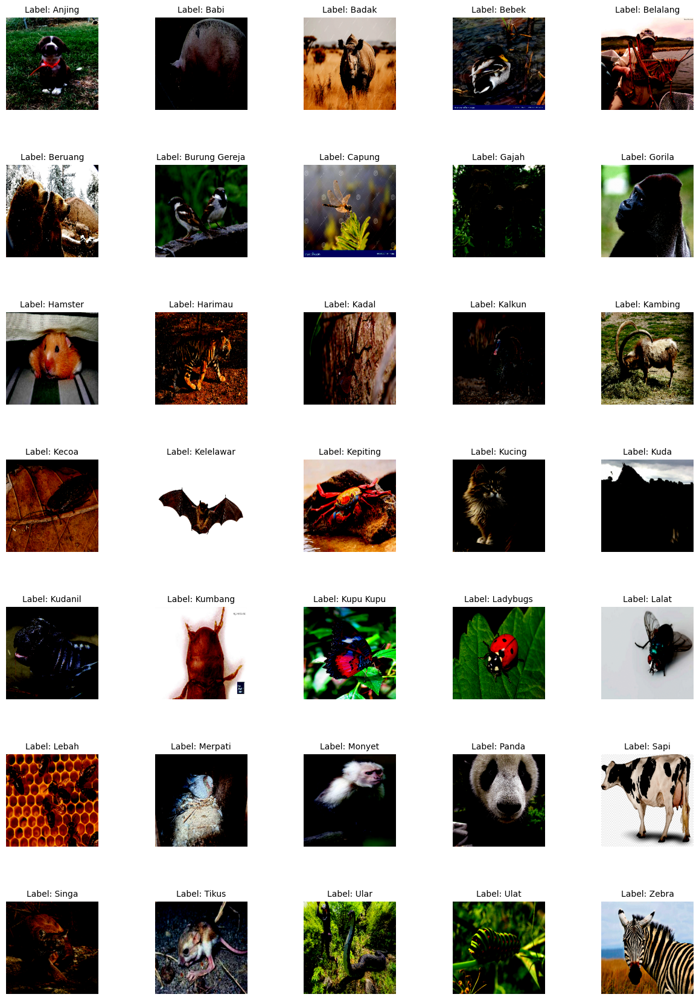

In [6]:
def display_sample_images_per_class(data_path, label_names):
    # Tentukan jumlah kolom dan baris
    num_cols = 5
    num_rows = (len(label_names) + num_cols - 1) // num_cols
    num_animal = 90
    # Buat figure dengan ukuran dinamis
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 3, num_rows * 3))
    axes = axes.flatten()

    for i, animal in enumerate(sorted(label_names)):
        ax = axes[i]
        animal_path = os.path.join(data_path, animal)

        if os.path.isdir(animal_path) and (images := sorted(os.listdir(animal_path))):
            # Ambil gambar pertama dari direktori
            image_path = os.path.join(animal_path, images[num_animal])
            image = preprocess_image(image_path)
            ax.imshow(image)
            ax.set_title(f"Label: {animal}", fontsize=10)
        else:
            ax.axis('off')  # Kosongkan subplot jika tidak ada gambar

        ax.axis('off')

    # Nonaktifkan subplot kosong (sisa di luar loop)
    for ax in axes[len(label_names):]:
        ax.axis('off')

    plt.subplots_adjust(wspace=0.4, hspace=0.6)
    plt.show()

# Contoh penggunaan
display_sample_images_per_class(data_path, animal_names)


## Encoding Label

In [7]:
# Mengubah label menjadi angka
label_encoder = LabelEncoder()
labels = label_encoder.fit_transform(label)


# Membagi dataset menjadi training (70%) dan remaining (30%)
train_data, remaining_data, train_labels, remaining_labels = train_test_split(
    data, labels, test_size=0.3, random_state=42, stratify=labels, shuffle=True
)

# Membagi remaining data menjadi validation (15%) dan test (15%)
val_data, test_data, val_labels, test_labels = train_test_split(
    remaining_data, remaining_labels, test_size=0.5, random_state=42, stratify=remaining_labels, shuffle=True
)

# Menampilkan bentuk dari setiap set data
print(f"Training set: {train_data.shape} images")
print(f"Training Label set: {train_labels.shape} labels")
print ('================================================')
print(f"Validation set: {val_data.shape} images")
print(f"Validation Label set: {val_labels.shape} labels")
print ('================================================')
print(f"Test set: {test_data.shape} images")
print(f"Test Label set: {test_labels.shape} labels")

Training set: (7344, 224, 224, 3) images
Training Label set: (7344,) labels
Validation set: (1574, 224, 224, 3) images
Validation Label set: (1574,) labels
Test set: (1574, 224, 224, 3) images
Test Label set: (1574,) labels


## Tampilkan Sample Data dan Label setelah Encoding

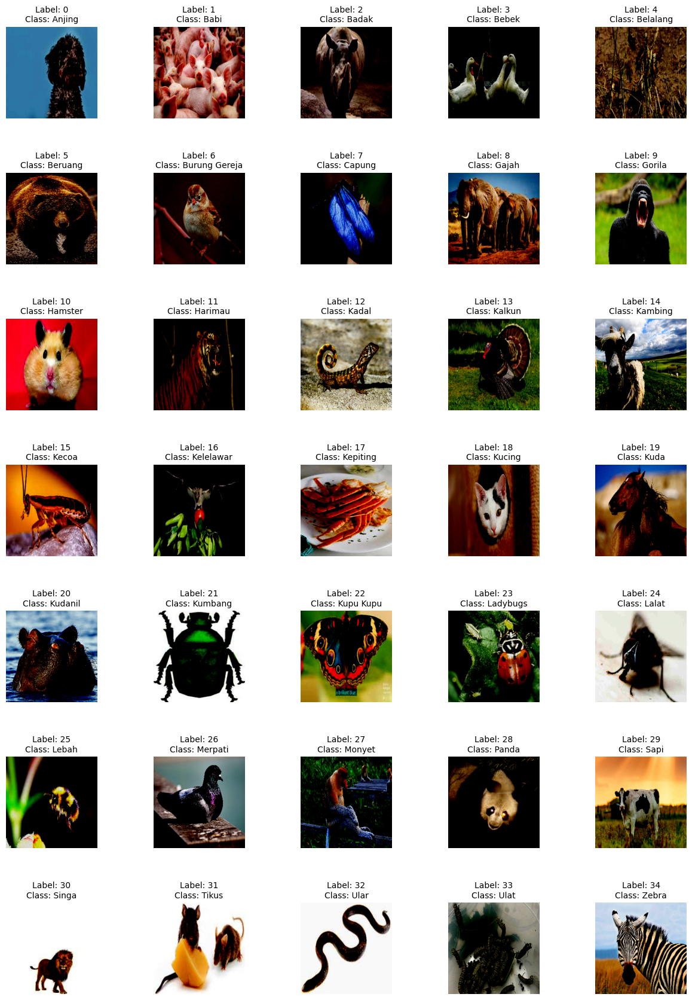

In [8]:
# Visualisasi untuk Memeriksa Data dan Label Setelah Label Encoding
def display_encoded_sample_images(data, labels, label_encoder, num_cols=5):
    unique_labels = np.unique(labels)
    num_rows = (len(unique_labels) + num_cols - 1) // num_cols  # Menghitung jumlah baris

    plt.figure(figsize=(num_cols * 3, num_rows * 3))  # Menyesuaikan ukuran figure
    for i, label in enumerate(unique_labels):
        idx = np.where(labels == label)[0][0]  # Ambil indeks dari label yang sesuai
        image = data[idx]
        plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(image)
        plt.title(f"Label: {label}\nClass: {label_encoder.inverse_transform([label])[0]}", fontsize=10)
        plt.axis('off')

    # Menambahkan ruang antara subplot untuk memastikan gambar lebih besar dan lebih mudah dilihat
    plt.subplots_adjust(wspace=0.4, hspace=0.6)
    plt.show()

# Tampilkan contoh gambar dari setiap kelas setelah encoding
display_encoded_sample_images(data, labels, label_encoder)


## Buat Fungsi Untuk Melihat History Training

In [9]:
# Fungsi untuk plot sejarah pelatihan model
def plot_training_history(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(acc) + 1)

    plt.figure(figsize=(12, 4))

    # Plot Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs, acc, 'r-', label='Training Accuracy')  # garis merah untuk training accuracy
    plt.plot(epochs, val_acc, 'b-', label='Validation Accuracy')  # garis biru untuk validation accuracy
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)  # Menambahkan grid

    # Plot Loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs, loss, 'r-', label='Training Loss')  # garis merah untuk training loss
    plt.plot(epochs, val_loss, 'b-', label='Validation Loss')  # garis biru untuk validation loss
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)  # Menambahkan grid

    plt.tight_layout()
    plt.show()


## Buat Early Stopping

In [10]:
# Menggunakan early stopping untuk menghindari overfitting
from tensorflow.keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)


## Data Augmentation

In [15]:
# Menggunakan ImageDataGenerator untuk augmentasi data
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

## MobilenetV2 untuk Base Model

In [12]:
# Fungsi untuk memuat model pretrained MobileNetV2
from tensorflow.keras.applications import MobileNetV2

def pretrained_model_MobileNetV2():
    pretrained_model = MobileNetV2(
        include_top=False,  # Tidak menyertakan top layer (fully connected layer)
        input_shape=(224, 224, 3),
        weights='imagenet'  # Menggunakan bobot yang telah dilatih pada dataset ImageNet
    )

    # Membekukan semua layer dalam model pretrained
    for layer in pretrained_model.layers:
        layer.trainable = False

    return pretrained_model


## Load Model and Create Final Model

In [17]:
# Memuat model pretrained MobileNetV2
base_model = pretrained_model_MobileNetV2()

# Fit data train ke dalam generator
datagen.fit(train_data)

# Menambahkan layer tambahan di atas base model
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = BatchNormalization(momentum=0.99)(x)
x = Dense(1024, activation='relu')(x)
x = Dense(512, activation = 'relu')(x)
x = BatchNormalization(momentum=0.99)(x)
x = Dense(256, activation = 'relu')(x)
x = Dropout (0.1) (x)
x = Dense(len(label_encoder.classes_), activation='softmax')(x)

# Membuat model akhir
model = Model(inputs=base_model.input, outputs=x)

# Membuat schedule learning rate berbasis decay
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.0001,  # Learning rate awal
    decay_steps=10000,            # Jumlah langkah sebelum decay
    decay_rate=0.96,              # Rasio decay
    staircase=True                # Jika True, decay berbentuk tangga
)

# Kompilasi model
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=lr_schedule), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Melihat ringkasan model
model.summary()


Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_3[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']      

## Train Model

Epoch 1/20
230/230 [==============================] - 472s 2s/step - loss: 1.5194 - accuracy: 0.6185 - val_loss: 0.6518 - val_accuracy: 0.8507
Epoch 2/20
230/230 [==============================] - 455s 2s/step - loss: 0.5805 - accuracy: 0.8396 - val_loss: 0.4389 - val_accuracy: 0.8831
Epoch 3/20
230/230 [==============================] - 451s 2s/step - loss: 0.4180 - accuracy: 0.8843 - val_loss: 0.4082 - val_accuracy: 0.8914
Epoch 4/20
230/230 [==============================] - 448s 2s/step - loss: 0.3375 - accuracy: 0.9025 - val_loss: 0.4007 - val_accuracy: 0.8926
Epoch 5/20
230/230 [==============================] - 447s 2s/step - loss: 0.2839 - accuracy: 0.9178 - val_loss: 0.3983 - val_accuracy: 0.8945
Epoch 6/20
230/230 [==============================] - 450s 2s/step - loss: 0.2409 - accuracy: 0.9289 - val_loss: 0.3855 - val_accuracy: 0.8958
Epoch 7/20
230/230 [==============================] - 446s 2s/step - loss: 0.1983 - accuracy: 0.9410 - val_loss: 0.3802 - val_accuracy: 0.9028

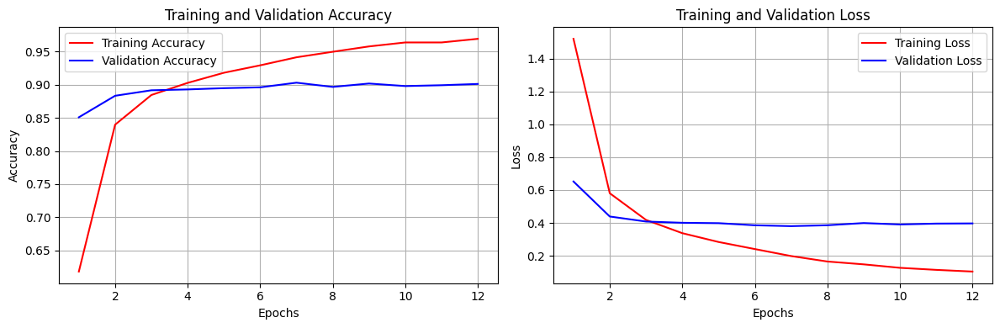

In [18]:
history = model.fit(
    datagen.flow(train_data, train_labels, batch_size=32),  # Menggunakan data augmentasi
    epochs=20,
    validation_data=(val_data, val_labels),
    callbacks=[early_stopping],  # Menggunakan early stopping
    shuffle=True  # Mengacak data setiap epoch
)

# Plot sejarah pelatihan
plot_training_history(history)

## Evaluate Model

In [19]:
model.evaluate(test_data, test_labels)

50/50 [==============================] - 73s 1s/step - loss: 0.3615 - accuracy: 0.9098


[0.36154821515083313, 0.9097840189933777]

##Confusion Matrix

50/50 [==============================] - 77s 2s/step


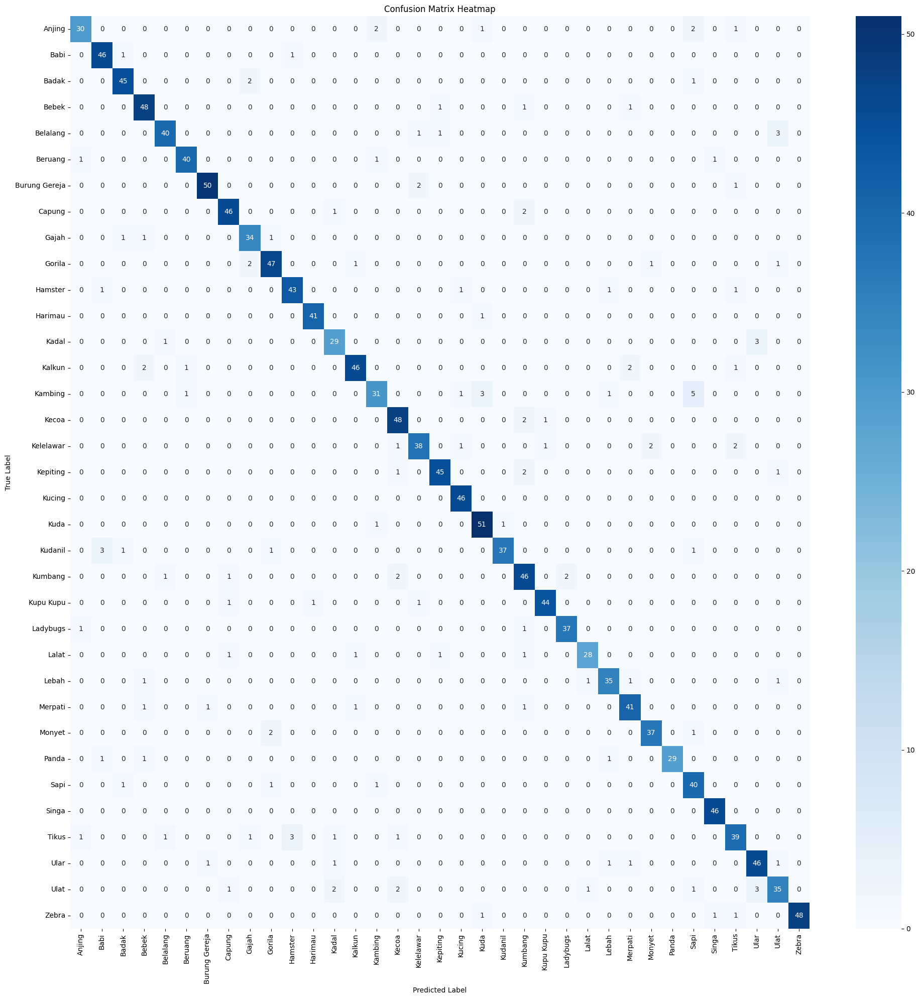

In [20]:
# Membuat prediksi pada data uji
y_pred = model.predict(test_data)

# Mengambil kelas dengan probabilitas tertinggi
y_pred_classes = np.argmax(y_pred, axis=1)

# Menghitung Confusion Matrix
cm = confusion_matrix(test_labels, y_pred_classes)

# Menampilkan Confusion Matrix sebagai heatmap
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xticks(rotation=90, fontsize=10)
plt.yticks(rotation=0, fontsize=10)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap')
plt.tight_layout()
plt.show()

## Classification Report


In [21]:

# Menghitung dan menampilkan classification report
report = classification_report(test_labels, y_pred_classes, target_names=label_encoder.classes_)
print(report)


               precision    recall  f1-score   support

       Anjing       0.91      0.83      0.87        36
         Babi       0.90      0.96      0.93        48
        Badak       0.92      0.94      0.93        48
        Bebek       0.89      0.94      0.91        51
     Belalang       0.93      0.89      0.91        45
      Beruang       0.95      0.93      0.94        43
Burung Gereja       0.96      0.94      0.95        53
       Capung       0.92      0.94      0.93        49
        Gajah       0.87      0.92      0.89        37
       Gorila       0.90      0.90      0.90        52
      Hamster       0.91      0.91      0.91        47
      Harimau       0.98      0.98      0.98        42
        Kadal       0.85      0.88      0.87        33
       Kalkun       0.94      0.88      0.91        52
      Kambing       0.86      0.74      0.79        42
        Kecoa       0.87      0.94      0.91        51
    Kelelawar       0.90      0.84      0.87        45
     Kepi

## Sample Prediksi Benar

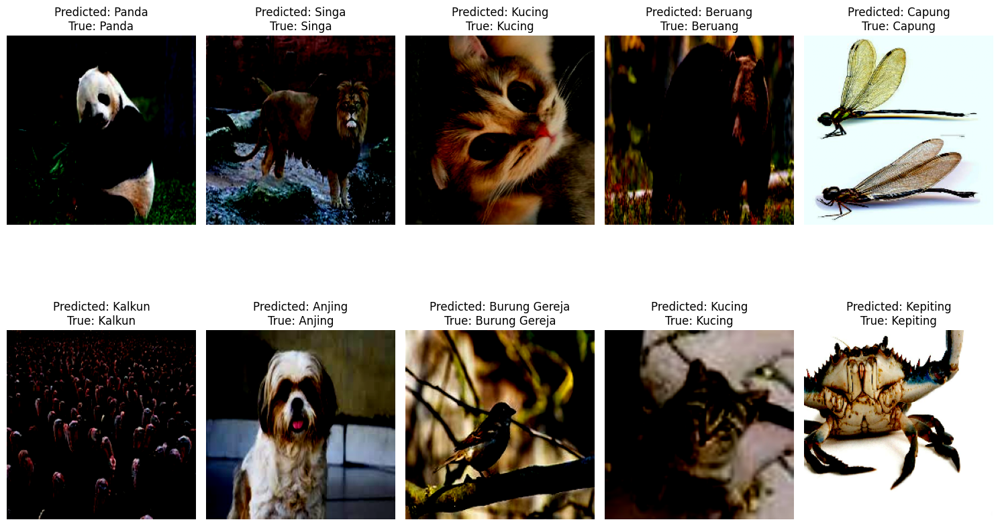

In [23]:
# Menemukan indeks dari prediksi yang benar
correct_indices = np.where(test_labels == y_pred_classes)[0]

# Memilih 10 indeks acak dari prediksi yang benar
selected_indices = np.random.choice(correct_indices, size=10, replace=False)

# Menampilkan gambar dan label yang diprediksi dengan benar
plt.figure(figsize=(15, 10))
for i, index in enumerate(selected_indices):
    plt.subplot(2, 5, i + 1)
    plt.imshow(test_data[index])
    plt.title(f"Predicted: {animal_names[y_pred_classes[index]]}\nTrue: {animal_names[test_labels[index]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()


## Sample Prediksi Salah

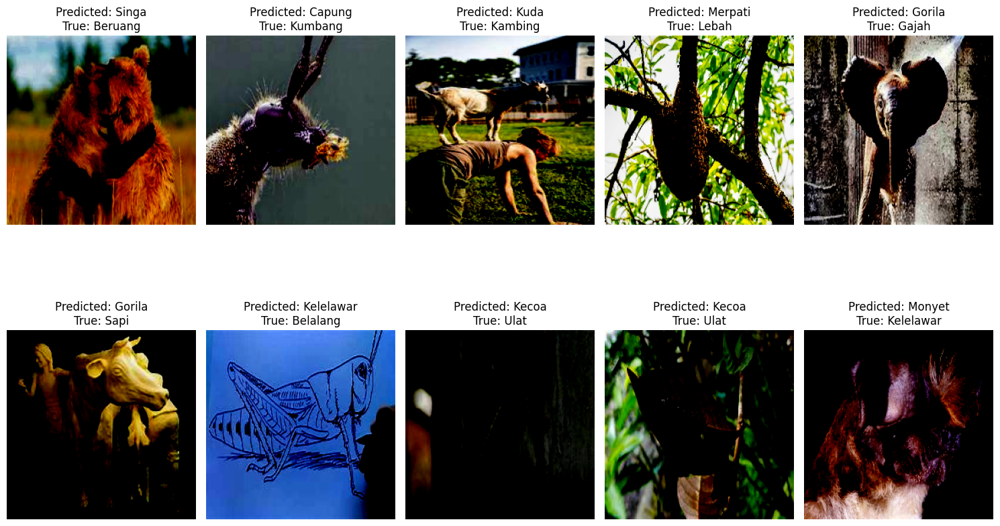

In [24]:
# Menemukan indeks dari prediksi yang salah
incorrect_indices = np.where(test_labels != y_pred_classes)[0]

# Memilih 10 indeks acak dari prediksi yang salah
selected_incorrect_indices = np.random.choice(incorrect_indices, size=10, replace=False)

# Menampilkan gambar dan label yang diprediksi salah
plt.figure(figsize=(15, 10))
for i, index in enumerate(selected_incorrect_indices):
    plt.subplot(2, 5, i + 1)
    plt.imshow(test_data[index])
    plt.title(f"Predicted: {animal_names[y_pred_classes[index]]}\nTrue: {animal_names[test_labels[index]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()


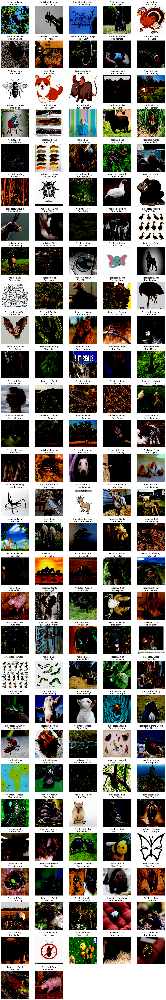

In [25]:
import numpy as np
import matplotlib.pyplot as plt

def display_all_incorrect_predictions(test_data, test_labels, y_pred_classes, animal_names):
    # Menemukan indeks dari prediksi yang salah
    incorrect_indices = np.where(test_labels != y_pred_classes)[0]

    # Menentukan jumlah gambar yang salah untuk pengaturan subplot
    num_incorrect = len(incorrect_indices)
    cols = 5
    rows = num_incorrect // cols + (num_incorrect % cols > 0)

    plt.figure(figsize=(cols * 3, rows * 3))
    for i, index in enumerate(incorrect_indices):
        plt.subplot(rows, cols, i + 1)
        plt.imshow(test_data[index])
        plt.title(f"Predicted: {animal_names[y_pred_classes[index]]}\nTrue: {animal_names[test_labels[index]]}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Contoh penggunaan fungsi
display_all_incorrect_predictions(test_data, test_labels, y_pred_classes, animal_names)


## Prediksi yang salah perkelas

Jumlah prediksi yang meleset di setiap kelas:
Panda: 3
Capung: 3
Belalang: 5
Anjing: 6
Kalkun: 6
Kumbang: 6
Kecoa: 3
Ular: 5
Merpati: 4
Ulat: 10
Lebah: 4
Tikus: 8
Beruang: 3
Kambing: 11
Lalat: 4
Hamster: 4
Sapi: 3
Kelelawar: 7
Kudanil: 6
Kadal: 4
Ladybugs: 2
Gorila: 5
Zebra: 3
Bebek: 3
Gajah: 3
Babi: 2
Harimau: 1
Monyet: 3
Badak: 3
Burung Gereja: 3
Kuda: 2
Kepiting: 4
Kupu Kupu: 3

Total prediksi yang salah: 142


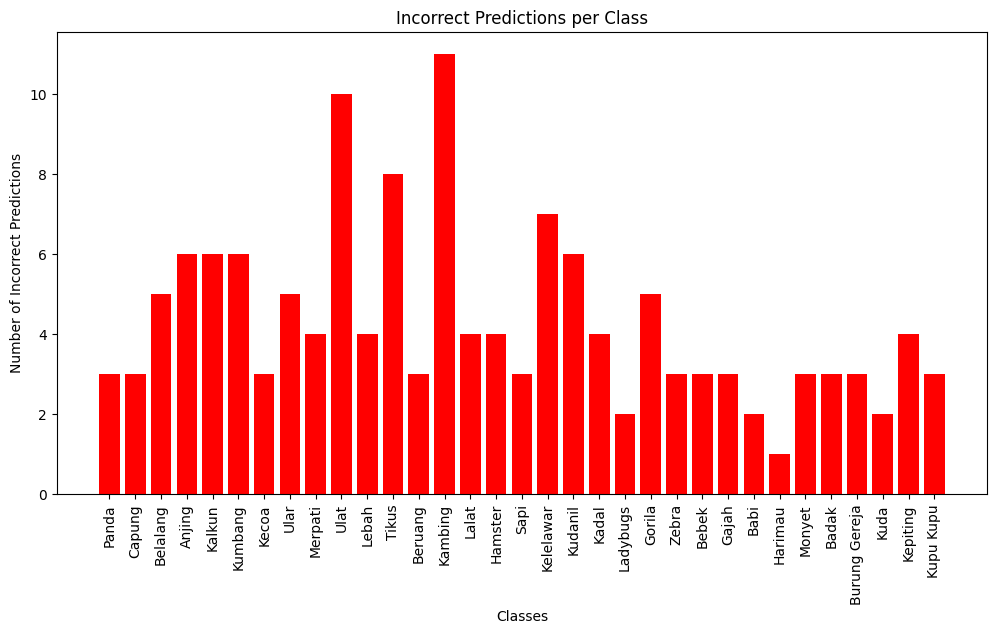

In [27]:
# Menghitung jumlah prediksi yang salah di setiap kelas
from collections import Counter

# Mengambil nama kelas berdasarkan indeks label
class_labels = label_encoder.classes_

# Inisialisasi counter untuk menghitung kesalahan prediksi
incorrect_count_per_class = Counter()

# Loop melalui indeks yang salah dan hitung kesalahan prediksi per kelas
for index in incorrect_indices:
    true_class = test_labels[index]
    predicted_class = y_pred_classes[index]
    incorrect_count_per_class[class_labels[true_class]] += 1

# Menampilkan jumlah prediksi yang meleset di setiap kelas
print("Jumlah prediksi yang meleset di setiap kelas:")
for class_name, count in incorrect_count_per_class.items():
    print(f"{class_name}: {count}")

# Menampilkan total prediksi yang salah
total_incorrect_predictions = len(incorrect_indices)
print(f"\nTotal prediksi yang salah: {total_incorrect_predictions}")

# Visualisasi jumlah prediksi yang meleset di setiap kelas
plt.figure(figsize=(12, 6))
plt.bar(incorrect_count_per_class.keys(), incorrect_count_per_class.values(), color='red')
plt.xticks(rotation=90)
plt.xlabel('Classes')
plt.ylabel('Number of Incorrect Predictions')
plt.title('Incorrect Predictions per Class')
plt.show()


## Tes dengan Data Baru

Saving cat.jpg to cat.jpg
Saving download (3).jpg to download (3).jpg
Saving download (2).jpg to download (2).jpg
Saving download (1).jpg to download (1).jpg
Saving images (1).jpg to images (1).jpg
Saving download.jpg to download.jpg
Saving capung.png to capung.png
Saving images.jpg to images.jpg
Saving kalkun kalkun.png to kalkun kalkun.png
Saving kalkun.png to kalkun.png
Saving ular.jpg to ular.jpg
Saving 3115129803.jpg to 3115129803.jpg
Saving butterfly.png to butterfly.png
Saving bear.jpg to bear.jpg
Saving tikus.jpg to tikus.jpg
Saving kumbang-kepik.jpg to kumbang-kepik.jpg
Saving kumbang.jpg to kumbang.jpg
Saving tiger.jpg to tiger.jpg
Saving monyet2.jpg to monyet2.jpg
1/1 [==============================] - 0s 45ms/step


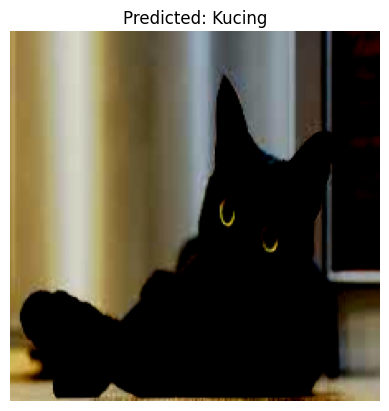

1/1 [==============================] - 0s 46ms/step


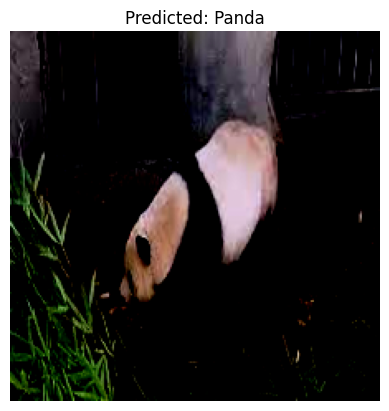

1/1 [==============================] - 0s 46ms/step


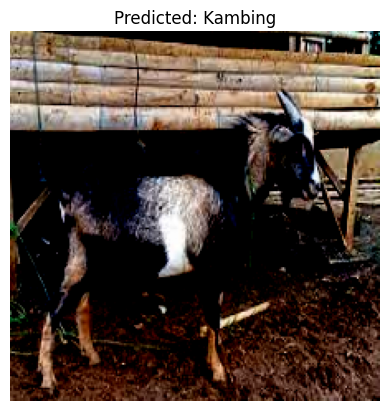

1/1 [==============================] - 0s 46ms/step


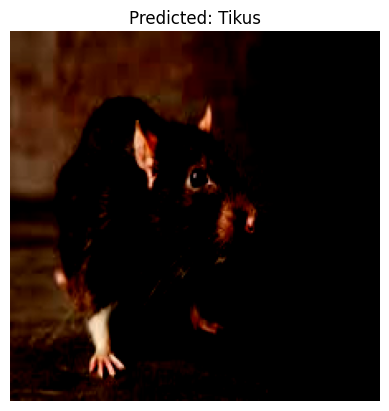

1/1 [==============================] - 0s 44ms/step


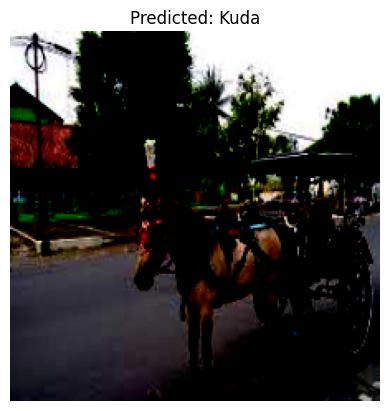

1/1 [==============================] - 0s 47ms/step


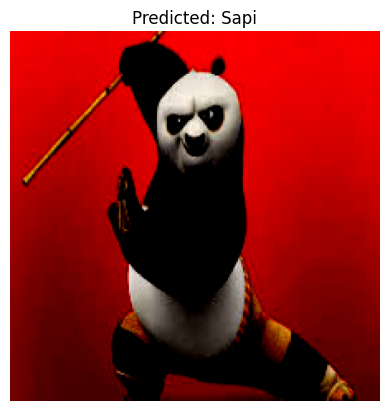

1/1 [==============================] - 0s 46ms/step


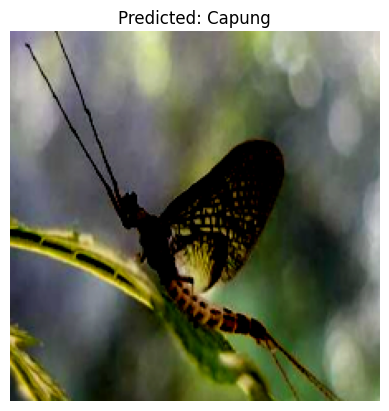

1/1 [==============================] - 0s 46ms/step


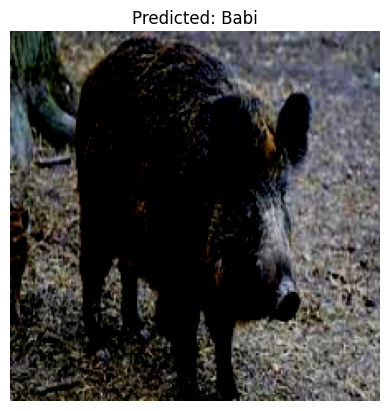

1/1 [==============================] - 0s 45ms/step


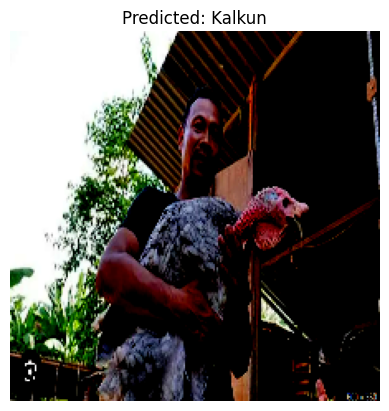

1/1 [==============================] - 0s 44ms/step


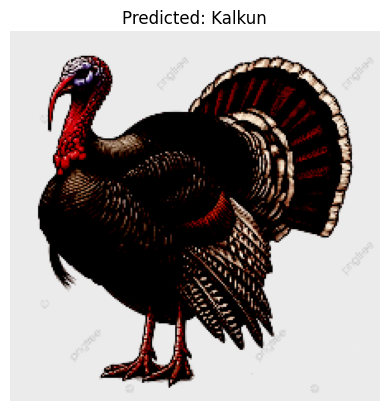

1/1 [==============================] - 0s 43ms/step


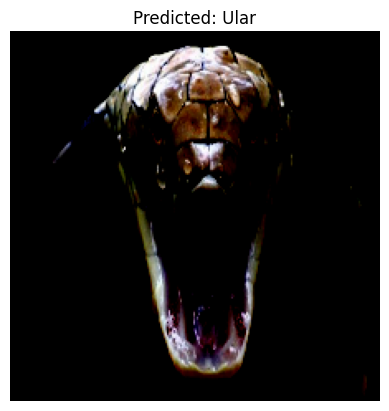

1/1 [==============================] - 0s 43ms/step


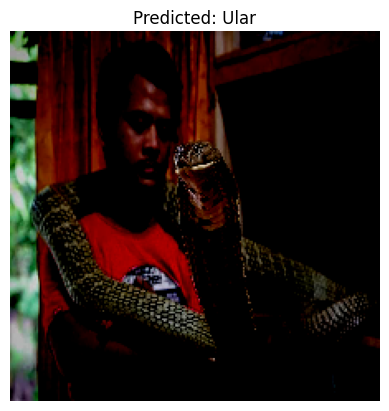

1/1 [==============================] - 0s 45ms/step


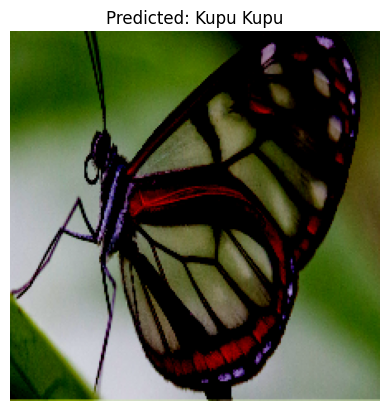

1/1 [==============================] - 0s 45ms/step


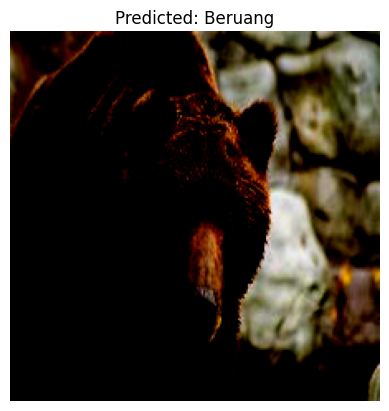

1/1 [==============================] - 0s 44ms/step


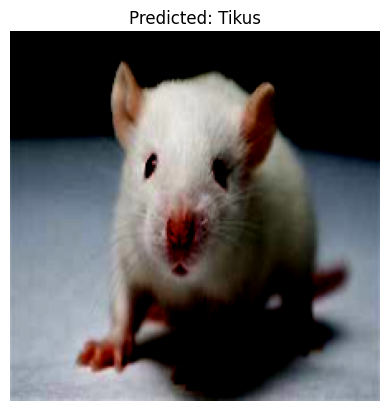

1/1 [==============================] - 0s 45ms/step


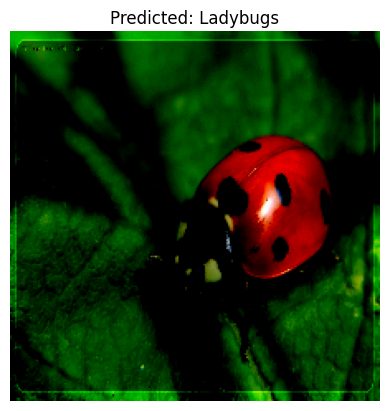

1/1 [==============================] - 0s 49ms/step


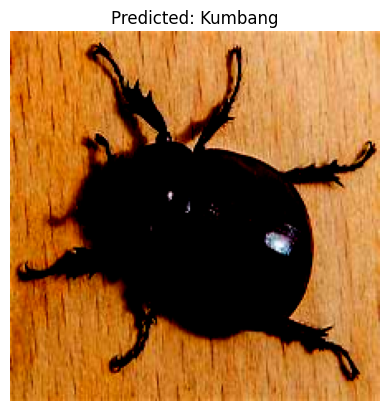

1/1 [==============================] - 0s 49ms/step


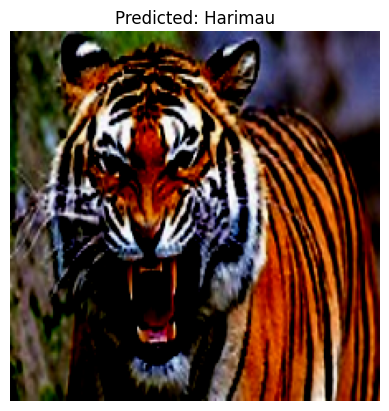

1/1 [==============================] - 0s 49ms/step


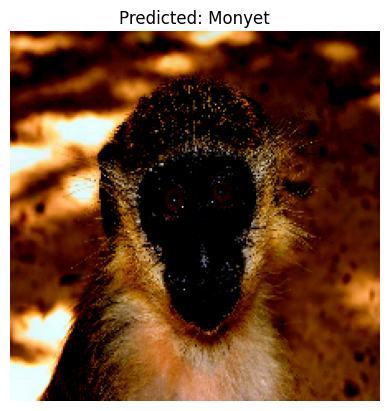

In [28]:
from google.colab import files
# Upload a new image
uploaded = files.upload()

for fn in uploaded.keys():
  # Preprocess the uploaded image
  path = fn
  img = preprocess_image(path)
  img = np.expand_dims(img, axis=0)

  # Make prediction
  prediction = model.predict(img)
  predicted_class = np.argmax(prediction, axis=1)
  predicted_label = label_encoder.inverse_transform(predicted_class)[0]

  # Display the image and the predicted label
  plt.imshow(img[0])
  plt.title(f"Predicted: {predicted_label}")
  plt.axis('off')
  plt.show()

## Save Model and Load Model

In [29]:
model.save('./model_weights/AnimalPeek90.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [31]:
loadmodel = tf.keras.models.load_model('/content/model_weights/AnimalPeek90.h5')

In [32]:
loadmodel.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_3[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']      

## Deploy TF Lite

In [ ]:
tf_lite_converter = tf.lite.TFLiteConverter.from_keras_model(loadmodel)
tflite_model = tf_lite_converter.convert()

In [34]:
tflite_name = 'AnimalPeek90.tflite'

with open(tflite_name, 'wb') as f:
  f.write(tflite_model)

## Download Model

In [35]:
from google.colab import files
files.download('/content/model_weights/AnimalPeek90.h5')
files.download('AnimalPeek90.tflite')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Create Model Metadata for Task Library and Codegen


<a name=image_classifiers></a>
### Image classifiers

See the [image classifier model compatibility requirements](https://www.tensorflow.org/lite/inference_with_metadata/task_library/image_classifier#model_compatibility_requirements) for more details about the supported model format.

Step 1: Import the required packages.

In [37]:
animal_names_sorted = sorted(os.listdir(data_path))

with open('AnimalPeek_Labels.txt', 'w') as f:
  for animal_name in animal_names_sorted:
    f.write(animal_name + '\n')

In [40]:
!pip install tflite-support-nightly

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 MB 16.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 11.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.3/243.3 kB 17.8 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.25.5
    Uninstalling protobuf-4.25.5:
      Successfully uninstalled protobuf-4.25.5


In [3]:
from tflite_support.metadata_writers import image_classifier
from tflite_support.metadata_writers import writer_utils

Step 2: Download the example image classifier, [mobilenet_v2_1.0_224.tflite](https://github.com/tensorflow/tflite-support/raw/master/tensorflow_lite_support/metadata/python/tests/testdata/image_classifier/mobilenet_v2_1.0_224.tflite), and the [label file](https://github.com/tensorflow/tflite-support/raw/master/tensorflow_lite_support/metadata/python/tests/testdata/image_classifier/labels.txt).

Step 3: Create metadata writer and populate.

In [4]:
ImageClassifierWriter = image_classifier.MetadataWriter
_MODEL_PATH = "/content/AnimalPeek90.tflite"
# Task Library expects label files that are in the same format as the one below.
_LABEL_FILE = "/content/AnimalPeek_Labels.txt"
_SAVE_TO_PATH = "AnimalPeek90_Metadata.tflite"
# Normalization parameters are required when reprocessing the image. It is
# optional if the image pixel values are in the range of [0, 255] and the input
# tensor is quantized to uint8. See the introduction for normalization and
# quantization parameters below for more details.
# https://www.tensorflow.org/lite/models/convert/metadata#normalization_and_quantization_parameters)
_INPUT_NORM_MEAN = 127.5
_INPUT_NORM_STD = 127.5

# Create the metadata writer.
writer = ImageClassifierWriter.create_for_inference(
    writer_utils.load_file(_MODEL_PATH), [_INPUT_NORM_MEAN], [_INPUT_NORM_STD],
    [_LABEL_FILE])

# Verify the metadata generated by the metadata writer.
print(writer.get_metadata_json())

# Populate the metadata into the model.
writer_utils.save_file(writer.populate(), _SAVE_TO_PATH)

{
  "name": "ImageClassifier",
  "description": "Identify the most prominent object in the image from a known set of categories.",
  "subgraph_metadata": [
    {
      "input_tensor_metadata": [
        {
          "name": "image",
          "description": "Input image to be classified.",
          "content": {
            "content_properties_type": "ImageProperties",
            "content_properties": {
              "color_space": "RGB"
            }
          },
          "process_units": [
            {
              "options_type": "NormalizationOptions",
              "options": {
                "mean": [
                  127.5
                ],
                "std": [
                  127.5
                ]
              }
            }
          ],
          "stats": {
            "max": [
              1.0
            ],
            "min": [
              -1.0
            ]
          }
        }
      ],
      "output_tensor_metadata": [
        {
          "name": "proba

In [5]:
from google.colab import files
files.download('/content/AnimalPeek90_Metadata.tflite')
files.download('/content/AnimalPeek_Labels.txt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## DONE!!